# Mapping the temporal and spatial dynamics of the human endometrium in vivo and in vitro

## Downstream analysis of Visium spots for endometrium and myometrium

## Libraries

In [1]:
import pandas as pd
import numpy as np
import anndata
import seaborn as sns
import scanpy as sc
import matplotlib.pyplot as plt
%matplotlib inline
import json
import cv2 # requires 'pip install opencv-python'

# custom script to plot spots that allows to zoom in
# do not import twice
import visium_plotting

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.4 scipy==1.3.2 pandas==0.25.3 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


### Defining paths to data

In [4]:
path = '/nfs/team292_visium_beta_phaseII/Sanger_PhaseII/new_data_20191209/Sanger_Visium_Beta_Phase_II_Manual_Align/'

# samples 152806 and 152810 are from donor A13 (Proliferative stage of the menstrual cycle)
# samples 152807 and 152811 are from donor A30 (Secretory stage of the menstrual cycle)

# sample IDs
IDs = ["152811", "152807", 
       "152810", "152806"]

In [5]:
# paths to objects

# objects with only spots under tissue
filtered_matrix_paths = ['./data/adata_'+ID+'_spots_under_tissue_raw_counts.h5ad' for ID in IDs]

# images provided by 10X Genomics
image_paths = [path + ID + '/' + ID + '_manual_spatial__tissue_hires_image.png' for ID in IDs]

# very high resolution in house images (exported from NDPI)
image_highest_res_paths = ['../data/' + ID + '_20x_highest_res_image.jpg' for ID in IDs]

# scale factors for spot coordinates
scalefactor_path = './scalefactors_dict.txt' 

## Reading data

In [6]:
%%time
images = {}
filtered_adatas = {}
scalefactors_dict = {}
images_highest_res = {}

for i in range(len(IDs)):
    
    images[IDs[i]] = cv2.imread(image_paths[i], -1)
    
    images_highest_res[IDs[i]] = cv2.imread(image_highest_res_paths[i], -1)
       
    filtered_adatas[IDs[i]] = sc.read(filtered_matrix_paths[i])

    
with open(scalefactor_path, 'r') as f:
    scalefactors_dict = json.load(f)


CPU times: user 25.9 s, sys: 30.8 s, total: 56.7 s
Wall time: 57 s


## Plotting marker genes (Fig.S7A) and genes/spot (n_genes, Fig. S2D)

In [7]:
# copying the raw counts into .raw attribute to plot raw marker gene expression
for ID in IDs:
    print('ID', ID)
    filtered_adatas[ID].raw = filtered_adatas[ID].copy() # this is raw counts

ID 152811
ID 152807
ID 152810
ID 152806


/opt/conda/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "
/opt/conda/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "
/opt/conda/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationW

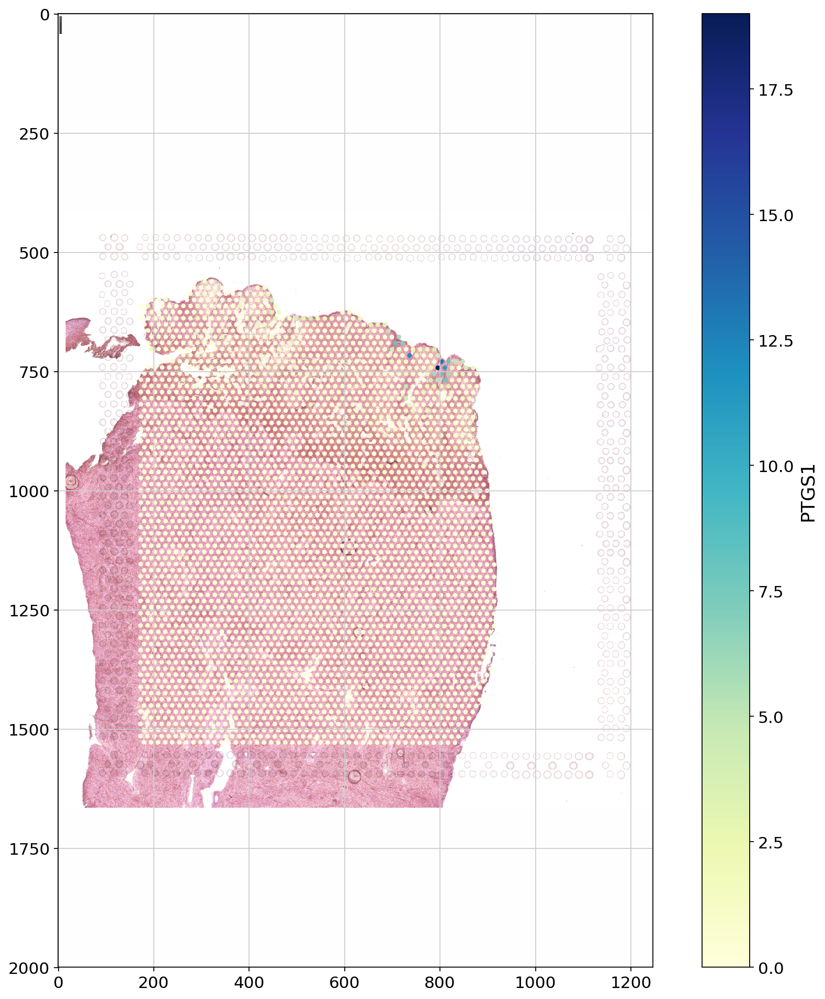

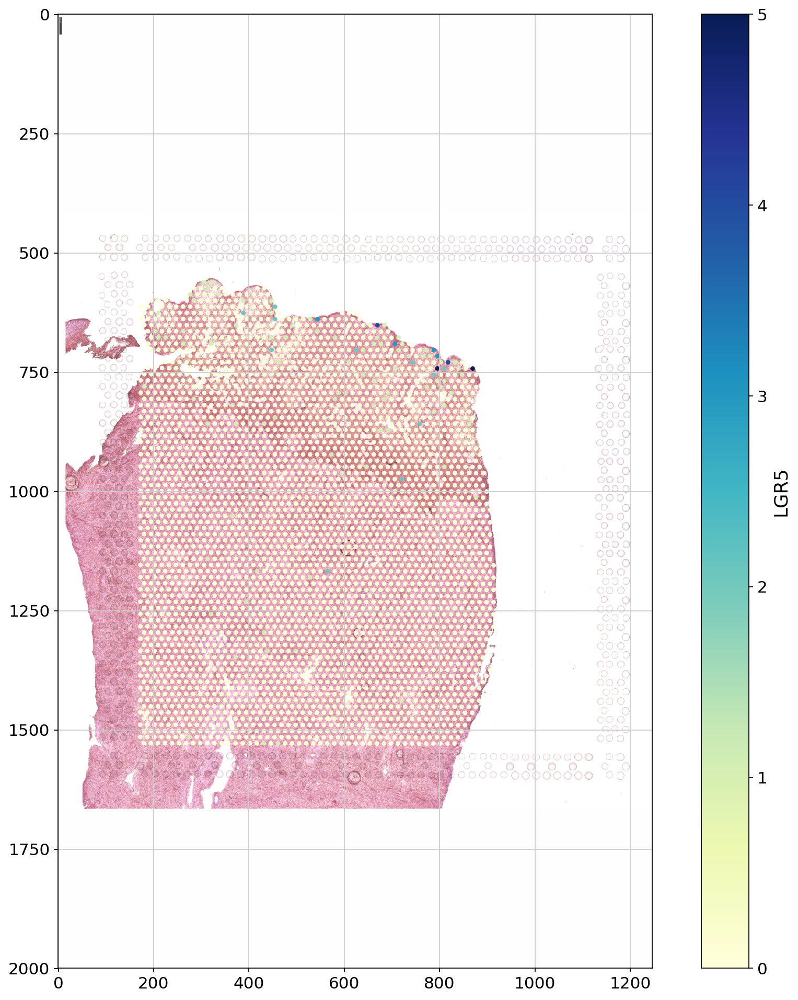

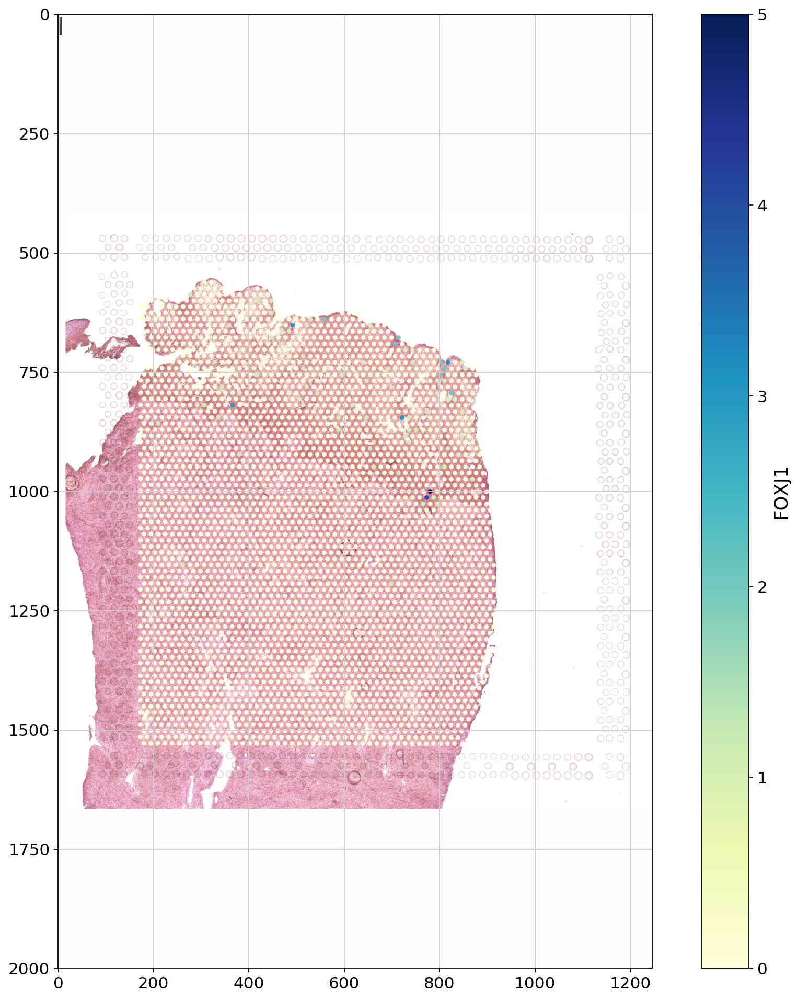

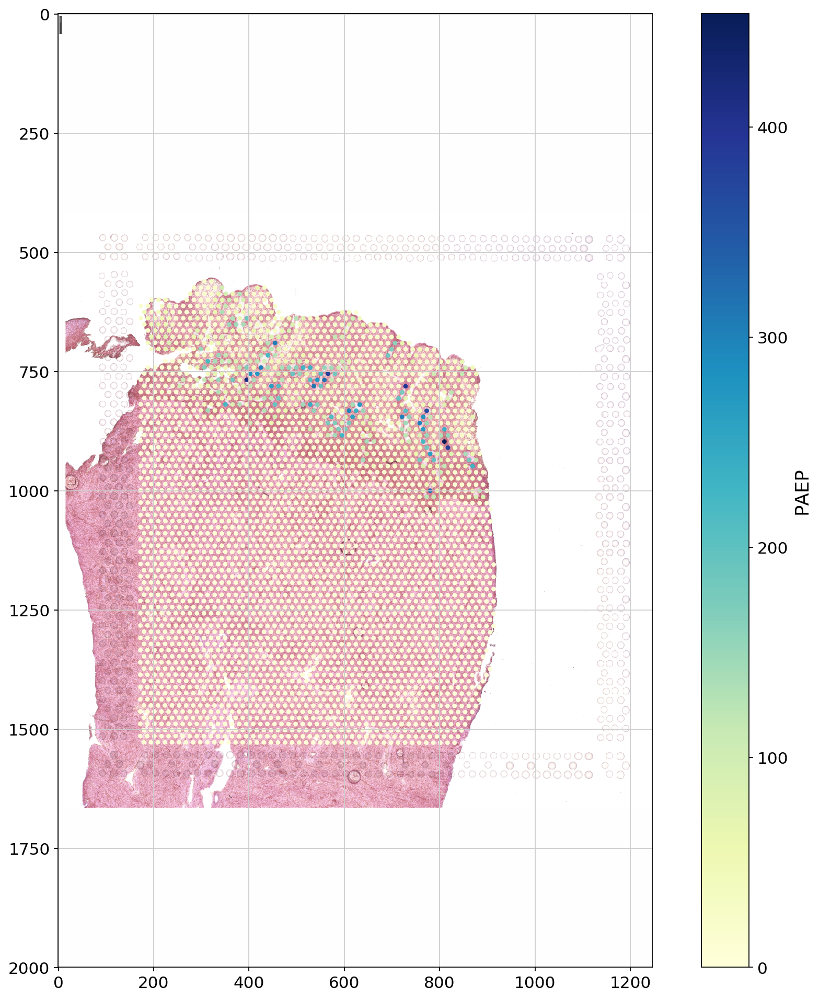

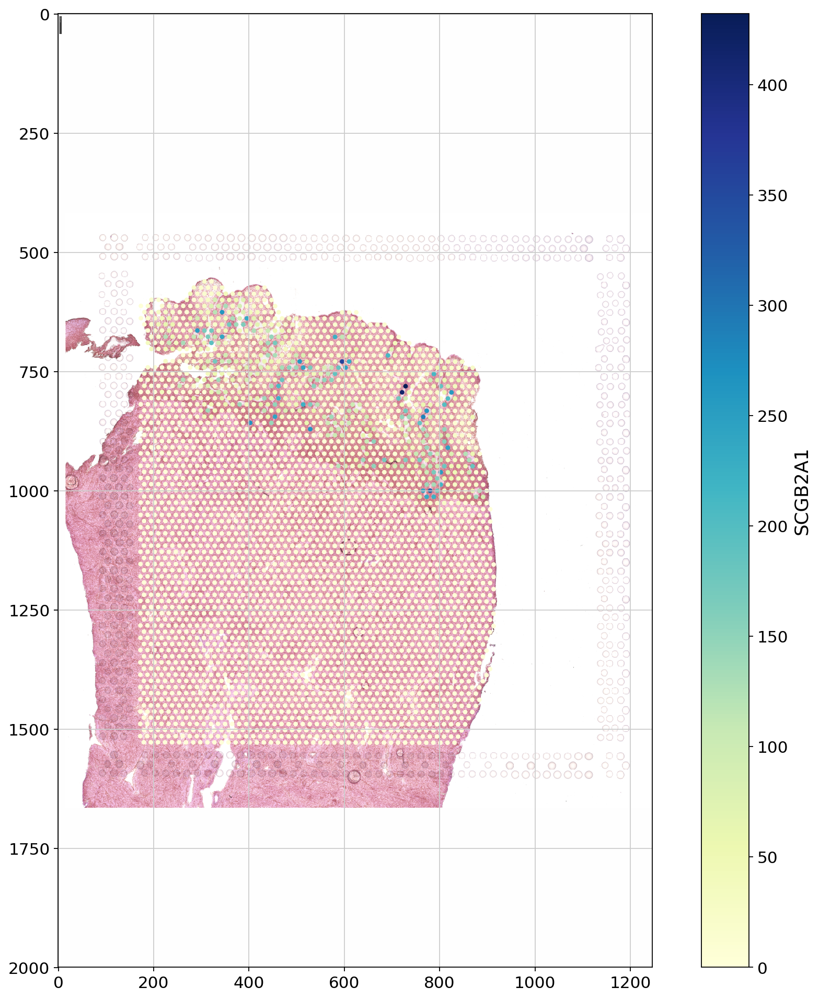

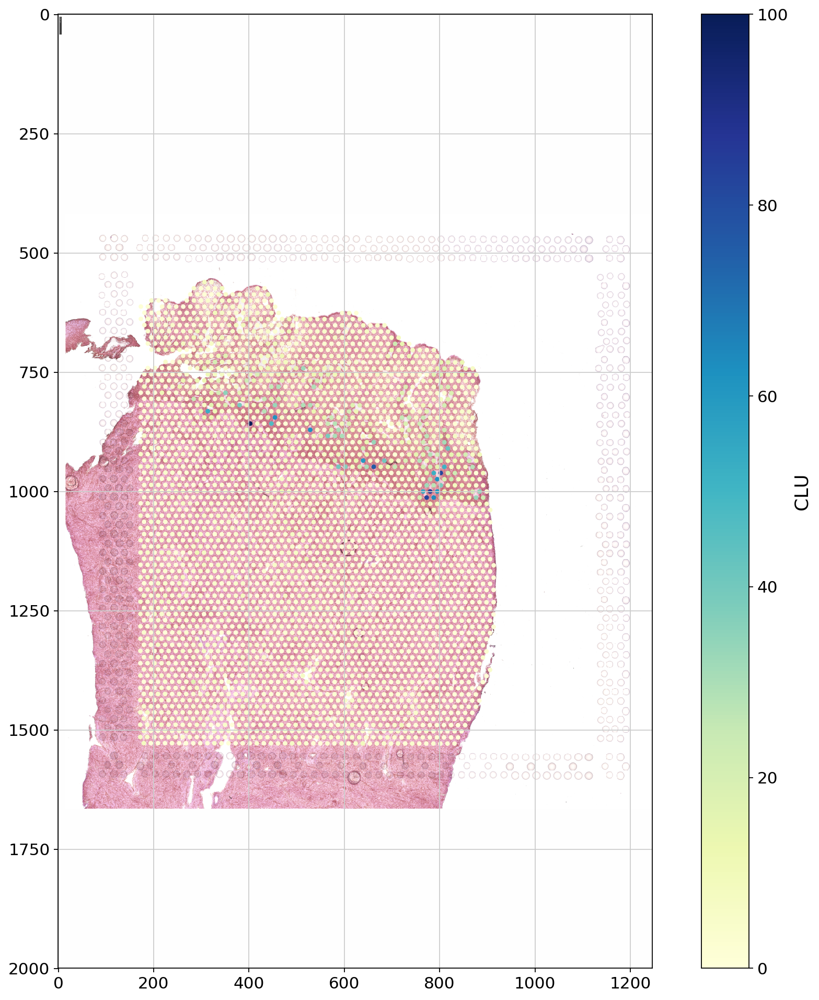

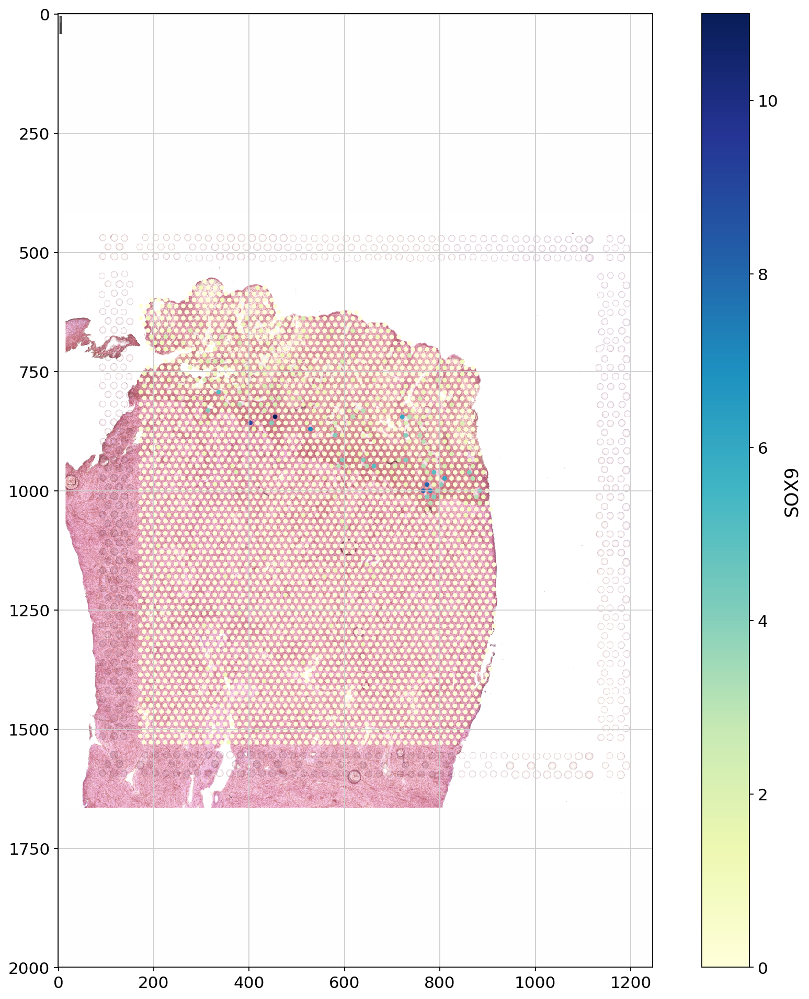

In [8]:
genes_to_plot = ['PTGS1','LGR5','FOXJ1','PAEP',
                'SCGB2A1','CLU', 'SOX9']

for gene in genes_to_plot:
    # this is normalised and log transformed counts
    visium_plotting.plot_spots_on_image(filtered_adatas['152807'], 
                    metric=gene, 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    color_map='YlGnBu',
                    figure_size = [15,15], 
                    metric_type = 'continuous', 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict
                    #, save_pdf_name='./figures/'+ID+'_'+gene+'_raw_counts.pdf'
                                       )

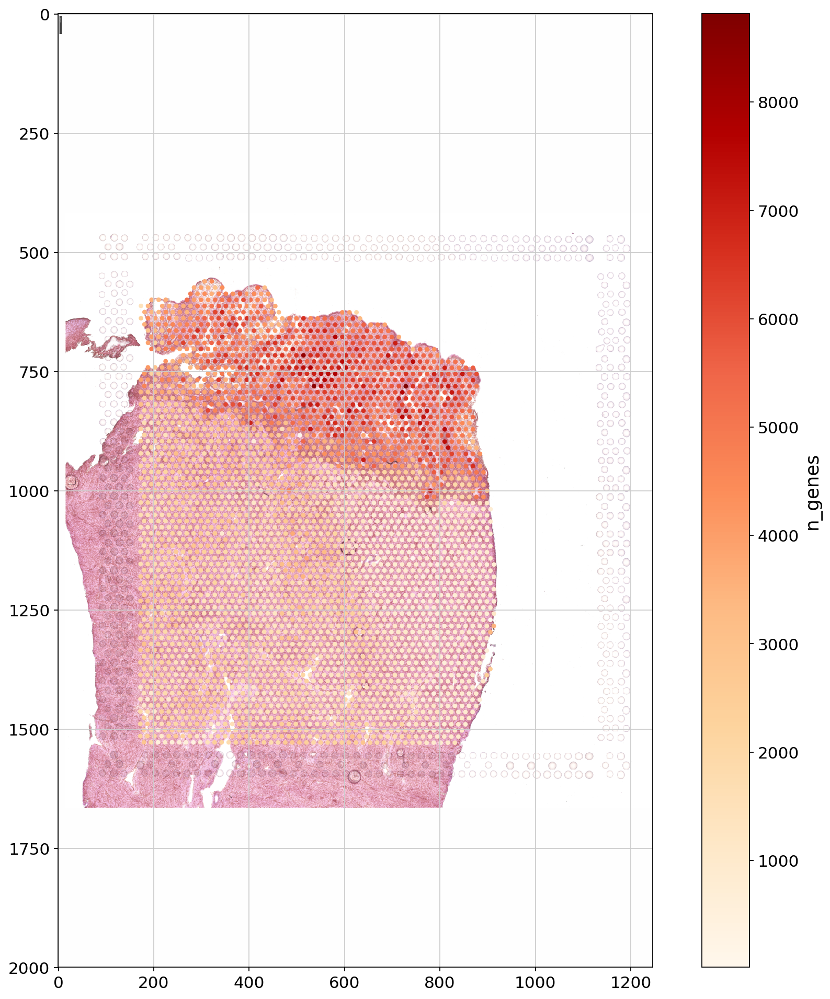

In [9]:
visium_plotting.plot_spots_on_image(filtered_adatas['152807'], 
                    metric='n_genes', 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    color_map='OrRd',
                    figure_size = [15,15], 
                    metric_type = 'continuous', 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict
                    #, save_pdf_name='./figures/'+ID+'_n_genes.pdf'
                                       )

## Processing and analysis of Visium spots

In [7]:
# normalising and log transforming the data
# then saving the normalised and log transformed values in .raw (actually raw) attribute
for ID in IDs:
    print('ID', ID)
    # normalise and log transform
    sc.pp.normalize_per_cell(filtered_adatas[ID], counts_per_cell_after=1e4)
    sc.pp.log1p(filtered_adatas[ID])
    filtered_adatas[ID].raw = filtered_adatas[ID].copy()

ID 152811
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
ID 152807
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
ID 152810
normalizing by total count per cell
filtered out 2 cells that haveless than 1 counts
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
ID 152806
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [8]:
for ID in IDs:
    print('ID',ID)
    sc.pp.highly_variable_genes(filtered_adatas[ID], 
                                flavor='seurat', n_top_genes=2000, inplace=True)


ID 152811
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
ID 152807
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
ID 152810
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
ID 152806
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm

In [9]:
# PCA, neighborhood graph and UMAP calculation
for ID in IDs:
    print('ID',ID)
    sc.pp.pca(filtered_adatas[ID], n_comps=50, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(filtered_adatas[ID])

    sc.tl.umap(filtered_adatas[ID])

ID 152811
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)
ID 152807
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)
ID 152810
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbor

## Identifying clusters of spots and analtomical regions corresponding to endometrium and myometrium

Fig. S3A

### Sample 152806

In [16]:
res = 0.6
ID = '152806'
sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res,
                  key_added='clusters_louvain_'+str(res))

# to not conflict with the color boundaries
filtered_adatas[ID].obs['clusters_louvain_'+str(res)] = filtered_adatas[ID].obs['clusters_louvain_'+str(res)].astype(float)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'clusters_louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:00)


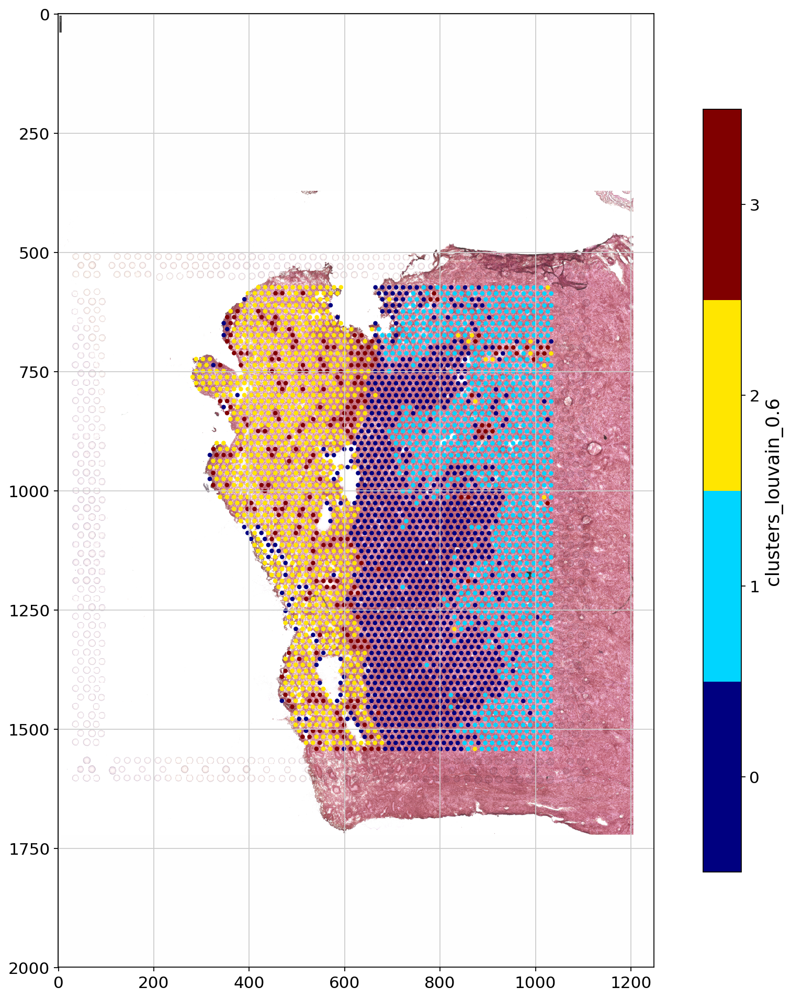

In [105]:
visium_plotting.plot_spots_on_image_import(filtered_adatas['152806'], 
                    metric='clusters_louvain_0.6', 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    #color_map_clusters = ['red','#4287f5','grey','#9c42f5', '#42f5e9', '#42f560', '#fffb00'], 
                    figure_size = [15,15], 
                    metric_type = 'discrete', 
                    filter_factor = None, 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict,
                    save_pdf_name='./figures/Clustering_of_spots/152806_spot_clusters_louvain.pdf')

### Louvain clusters to regions:
- 0,1 - myometrium
- 2,3 - endometrium

### Sample 152810

In [18]:
res = 0.3
ID = '152810'
sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res,
                  key_added='clusters_louvain_'+str(res))

# to not conflict with the color boundaries
filtered_adatas[ID].obs['clusters_louvain_'+str(res)] = filtered_adatas[ID].obs['clusters_louvain_'+str(res)].astype(float)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'clusters_louvain_0.3', the cluster labels (adata.obs, categorical) (0:00:00)


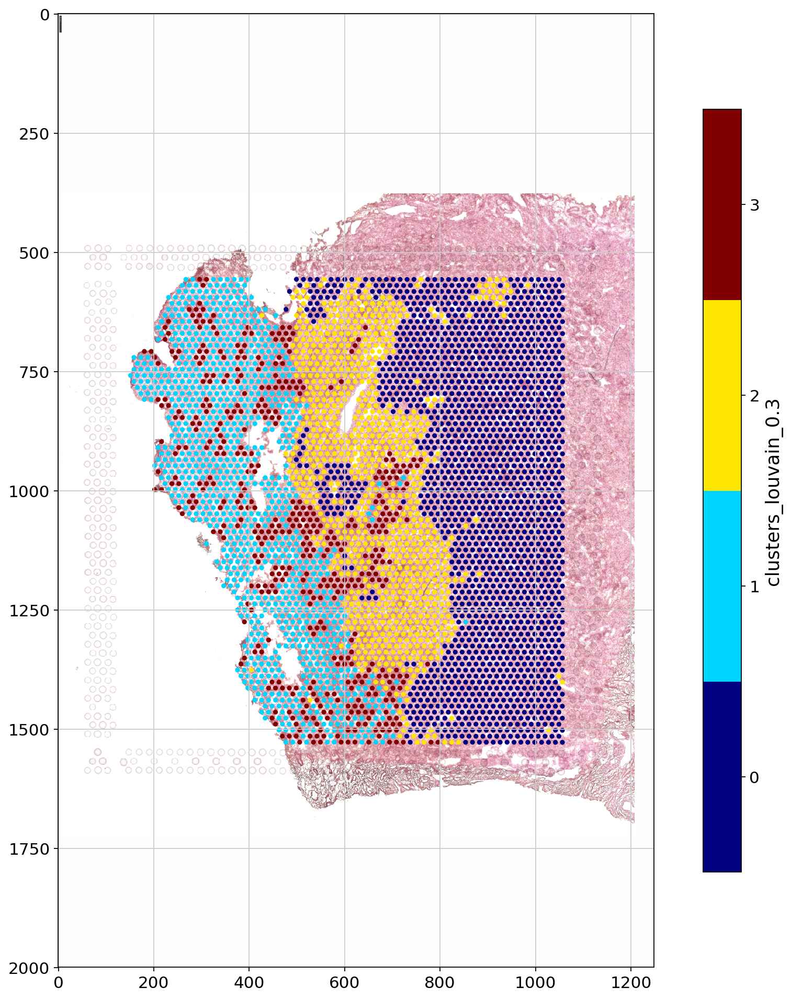

In [104]:
visium_plotting.plot_spots_on_image_import(filtered_adatas['152810'], 
                    metric='clusters_louvain_0.3', 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    figure_size = [15,15], 
                    metric_type = 'discrete', 
                    filter_factor = None, 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict ,
                    save_pdf_name='./figures/Clustering_of_spots/152810_spot_clusters_louvain.pdf')

### Louvain clusters to regions:
- 0,2 - myometrium
- 1,3 - endometrium

### Sample 152807

In [20]:
res = 0.5
ID = '152807'
sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res,
                  key_added='clusters_louvain_'+str(res))

# to not conflict with the color boundaries
filtered_adatas[ID].obs['clusters_louvain_'+str(res)] = filtered_adatas[ID].obs['clusters_louvain_'+str(res)].astype(float)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'clusters_louvain_0.5', the cluster labels (adata.obs, categorical) (0:00:00)


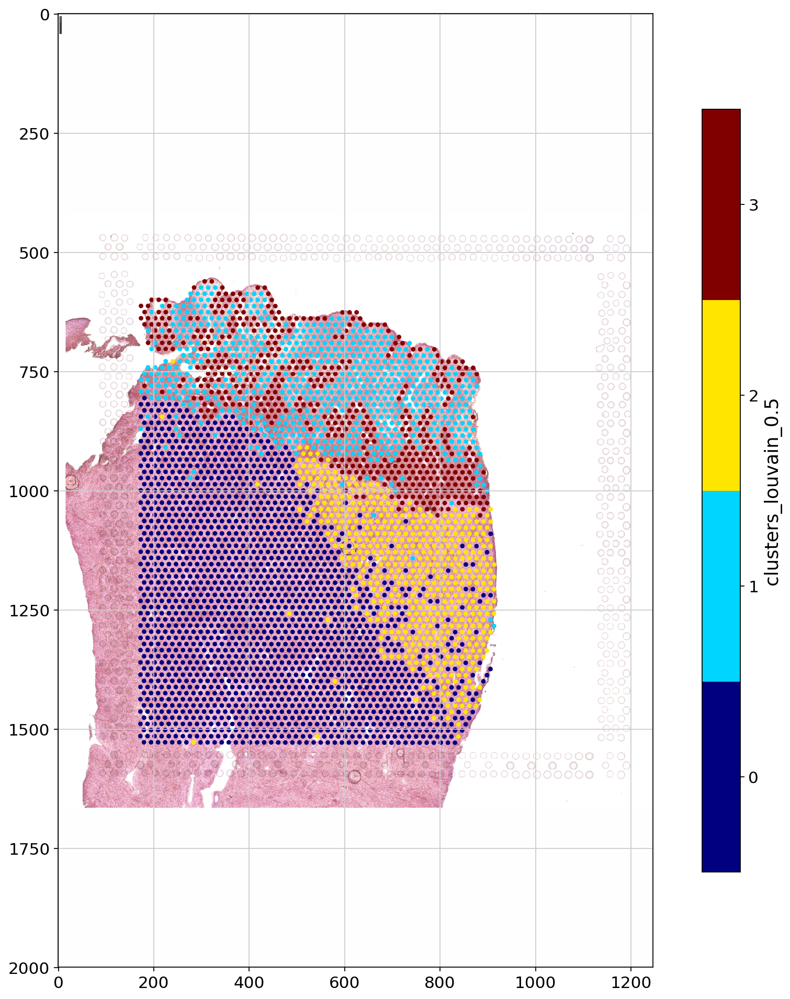

In [103]:
visium_plotting.plot_spots_on_image_import(filtered_adatas['152807'], 
                    metric='clusters_louvain_0.5', 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    figure_size = [15,15], 
                    metric_type = 'discrete', 
                    filter_factor = None, 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict,
                    save_pdf_name='./figures/Clustering_of_spots/152807_spot_clusters_louvain.pdf')

### Louvain clusters to regions:
- 0,2 - myometrium
- 1,3 - endometrium

### Sample 152811

In [22]:
res = 0.7
ID = '152811'
sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res,
                  key_added='clusters_louvain_'+str(res))

# to not conflict with the color boundaries
filtered_adatas[ID].obs['clusters_louvain_'+str(res)] = filtered_adatas[ID].obs['clusters_louvain_'+str(res)].astype(float)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'clusters_louvain_0.7', the cluster labels (adata.obs, categorical) (0:00:00)


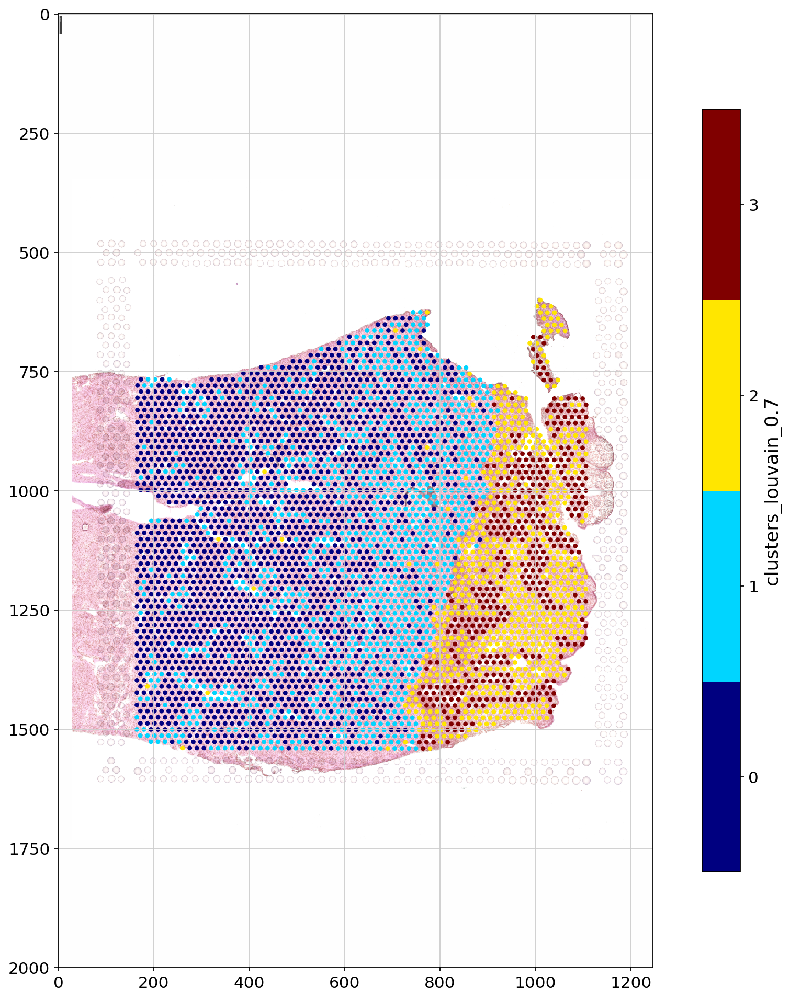

In [102]:
visium_plotting.plot_spots_on_image_import(filtered_adatas['152811'], 
                    metric='clusters_louvain_0.7', 
                    res = 'high_10x', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1, 
                    figure_size = [15,15], 
                    metric_type = 'discrete', 
                    filter_factor = None, 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict,
                    save_pdf_name='./figures/Clustering_of_spots/152811_spot_clusters_louvain.pdf')

### Louvain clusters to regions:
- 0,1 - myometrium
- 2,3 - endometrium

## Taking a closer look at epithelial spots from sample 152807 (cluster 3)

In [33]:
ID = '152807'

res = 0.5
res_restr = 1.0

sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res,
                  key_added='clusters_louvain_'+str(res))

sc.tl.louvain(filtered_adatas[ID], 
                  resolution=res_restr,
                  key_added='clusters_louvain_restr_glands_res_'+str(res_restr), 
             restrict_to =('clusters_louvain_0.5',['3']))

key_new = 'clusters_louvain_restr_glands_res_'+str(res_restr)

# to not conflict with the color boundaries
filtered_adatas[ID].obs[key_new] = [elem.replace('-','') for elem in filtered_adatas[ID].obs[key_new]]
filtered_adatas[ID].obs[key_new] = [elem.replace(',','') for elem in filtered_adatas[ID].obs[key_new]]
filtered_adatas[ID].obs[key_new] = filtered_adatas[ID].obs[key_new].astype(float)

filtered_adatas[ID].obs['clusters_louvain_'+str(res)] = filtered_adatas[ID].obs['clusters_louvain_'+str(res)].astype(float)


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'clusters_louvain_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'clusters_louvain_restr_glands_res_1.0', the cluster labels (adata.obs, categorical) (0:00:00)


Fig. 3A

filtering spots by some key
selected spots table:  (479, 52)


/opt/conda/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


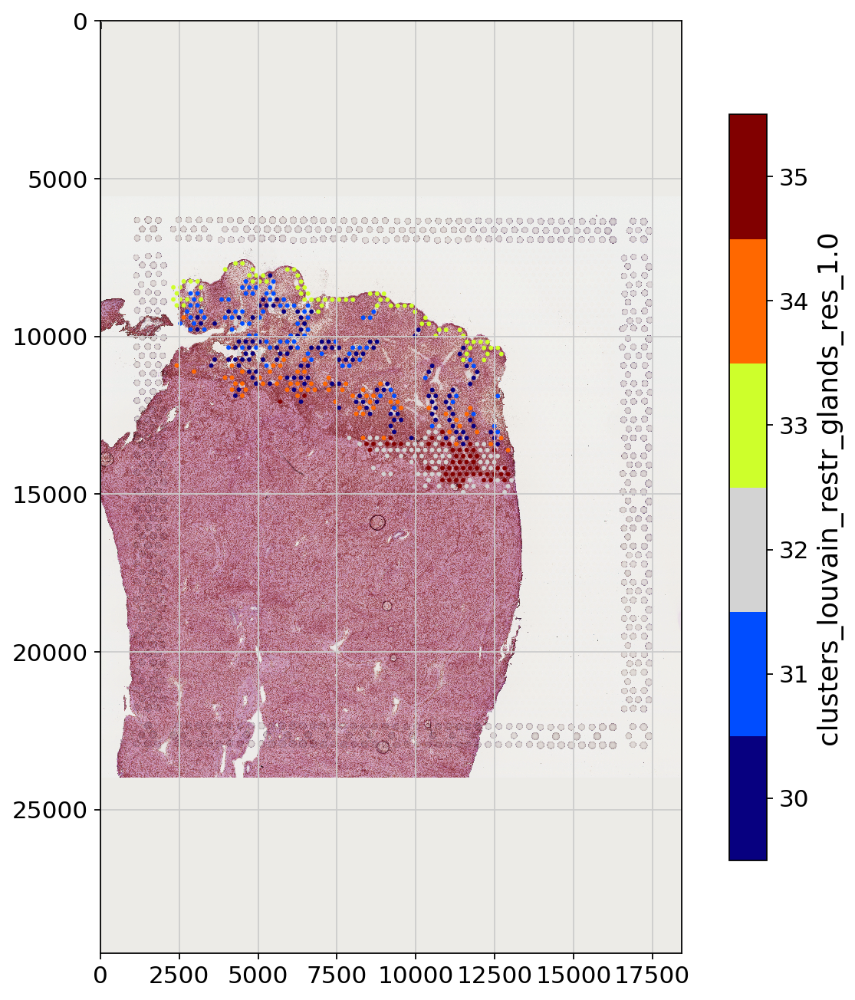

In [101]:
visium_plotting.plot_spots_on_image_import(filtered_adatas['152807'], 
                    metric='clusters_louvain_restr_glands_res_1.0', 
                    res = 'highest', # resolution of the image to plot, either 'high_10X' - the high res image that 10X provide 
                                          # or 'highest' - highest resolution, 20x jpeg import from NDPI
                    transparency_coeff = 1,
                    # custom color map
                    color_map_clusters = ['#070080','#004dff',
                                           'lightgrey','#ceff2b','#ff6800','#810000'], 
                    figure_size = [10,10], 
                    metric_type = 'discrete', 
                    # selecting only epithelial spots
                    filter_factor = filtered_adatas['152807'][filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] > 29].obs, 
                    highest_res_images_dict = images_highest_res, 
                    images_dict_10x = images, 
                    scalefactors_dict = scalefactors_dict,
                    save_pdf_name='./figures/Clustering_of_spots/152807_epi_spots_louvain.pdf')

### Defining subpopulations of epithelial spots

- cluster 33 --> luminal
- clusters 30, 31 --> glandular
- clusters 34, 35 --> basal

(discarding cluster 32)

# DE analysis with limma

Following comparisons:
- luminal spots vs rest (basal + glandular)
- basal spots vs rest (luminal + glandular)
- glandular spots vs rest (luminal + basal)

In [41]:
np.unique(filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'])

array([ 0.,  1.,  2., 30., 31., 32., 33., 34., 35.])

In [42]:
# picking only epi spots and discarding cluster 32
adata_epi_spots = filtered_adatas['152807'][(filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] == 30)
                                                | (filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] == 31)
                                                | (filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] == 33)
                                                | (filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] == 34)
                                                | (filtered_adatas['152807'].obs['clusters_louvain_restr_glands_res_1.0'] == 35)]


In [43]:
def annot_luminal_vs_rest(adata_obj, spot_id):
    curr_subcluster = adata_obj.obs.loc[spot_id,'clusters_louvain_restr_glands_res_1.0']
    if curr_subcluster == 33:
        ans = 'epi_luminal'
    else:
        ans = 'epi_rest'
    return(ans)

def annot_basal_vs_rest(adata_obj, spot_id):
    curr_subcluster = adata_obj.obs.loc[spot_id,'clusters_louvain_restr_glands_res_1.0']
    if curr_subcluster in [34,35]:
        ans = 'epi_basal'
    else:
        ans = 'epi_rest'
    return(ans)

def annot_glandular_vs_rest(adata_obj, spot_id):
    curr_subcluster = adata_obj.obs.loc[spot_id,'clusters_louvain_restr_glands_res_1.0']
    if curr_subcluster in [30,31]:
        ans = 'epi_glandular'
    else:
        ans = 'epi_rest'
    return(ans)


In [44]:
adata_epi_spots.obs['spot_id'] = adata_epi_spots.obs.index

Trying to set attribute `.obs` of view, making a copy.


In [45]:
adata_epi_spots.obs['luminal_or_rest'] = adata_epi_spots.obs['spot_id'].apply(lambda x: annot_luminal_vs_rest(adata_epi_spots,
                                                                                                            x))
adata_epi_spots.obs['basal_or_rest'] = adata_epi_spots.obs['spot_id'].apply(lambda x: annot_basal_vs_rest(adata_epi_spots,
                                                                                                            x))
adata_epi_spots.obs['glandular_or_rest'] = adata_epi_spots.obs['spot_id'].apply(lambda x: annot_glandular_vs_rest(adata_epi_spots,
                                                                                                            x))

In [49]:
adata_full_raw = anndata.AnnData(X=adata_epi_spots.raw.X,
                            obs=adata_epi_spots.obs,
                            var=adata_epi_spots.raw.var,
                            obsm=adata_epi_spots.obsm)

In [50]:
adata_full_raw.obs['sample'] = ['152807']*len(adata_full_raw.obs)

In [82]:
# marker calling

t = adata_full_raw.X.toarray().T
df = pd.DataFrame(data=t, columns= adata_full_raw.obs.index, index=adata_full_raw.var_names)

meta_df = pd.DataFrame(data={'Cell':list(adata_full_raw.obs.index),
                             'cell_type':[ str(i) for i in adata_full_raw.obs['basal_or_rest']],
                             'sample':[ str(i) for i in adata_full_raw.obs['sample']]})
meta_df.set_index('Cell', inplace=True)

In [83]:
meta_df

,cell_type,sample
Cell,,
AAATGCTCGTTACGTT-1,epi_rest,152807
AACACGACTGTACTGA-1,epi_rest,152807
AACCTTTACGACGTCT-1,epi_rest,152807
AACGATATGTCAACTG-1,epi_rest,152807
AACGTGCGAAAGTCTC-1,epi_basal,152807
...,...,...
TTGGCCATCTTGCGCT-1,epi_rest,152807
TTGGCTCGCATGAGAC-1,epi_basal,152807
TTGTAAGGCCAGTTGG-1,epi_rest,152807


In [84]:
np.unique(meta_df['cell_type'], return_counts=True)

(array(['epi_basal', 'epi_rest'], dtype=object), array([119, 285]))

In [85]:
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [86]:
outpath = './limma_DEG/'

In [87]:
%%R
library(limma)
library(edgeR)

In [88]:
meta_df.reset_index(inplace=True)

In [89]:
meta_df

,Cell,cell_type,sample
0,AAATGCTCGTTACGTT-1,epi_rest,152807
1,AACACGACTGTACTGA-1,epi_rest,152807
2,AACCTTTACGACGTCT-1,epi_rest,152807
3,AACGATATGTCAACTG-1,epi_rest,152807
4,AACGTGCGAAAGTCTC-1,epi_basal,152807
...,...,...,...
399,TTGGCCATCTTGCGCT-1,epi_rest,152807
400,TTGGCTCGCATGAGAC-1,epi_basal,152807
401,TTGTAAGGCCAGTTGG-1,epi_rest,152807
402,TTGTATCACACAGAAT-1,epi_rest,152807


In [90]:
# because R replace '-' with '.' in df for some reason
def rename_Cell(cell_id):
    return(cell_id.replace('-','.'))

In [91]:
meta_df['Cell'] = meta_df['Cell'].apply(lambda x: rename_Cell(x))

In [92]:
meta_df

,Cell,cell_type,sample
0,AAATGCTCGTTACGTT.1,epi_rest,152807
1,AACACGACTGTACTGA.1,epi_rest,152807
2,AACCTTTACGACGTCT.1,epi_rest,152807
3,AACGATATGTCAACTG.1,epi_rest,152807
4,AACGTGCGAAAGTCTC.1,epi_basal,152807
...,...,...,...
399,TTGGCCATCTTGCGCT.1,epi_rest,152807
400,TTGGCTCGCATGAGAC.1,epi_basal,152807
401,TTGTAAGGCCAGTTGG.1,epi_rest,152807
402,TTGTATCACACAGAAT.1,epi_rest,152807


In [93]:
df

index,AAATGCTCGTTACGTT-1,AACACGACTGTACTGA-1,AACCTTTACGACGTCT-1,AACGATATGTCAACTG-1,AACGTGCGAAAGTCTC-1,AACTTCTGCGTCTATC-1,AAGACTAACCCGTTGT-1,AAGAGGCATGGATCGC-1,AAGGATGAGGGACCTC-1,AAGGCGCGTAAAGCTT-1,...,TTCTTGTAACCTAATG-1,TTGCTGATCATGTTCG-1,TTGCTGCACCTATCCA-1,TTGGAGTCTCCCTTCT-1,TTGGATTGGGTACCAC-1,TTGGCCATCTTGCGCT-1,TTGGCTCGCATGAGAC-1,TTGTAAGGCCAGTTGG-1,TTGTATCACACAGAAT-1,TTGTTCAGTGTGCTAC-1
index,,,,,,,,,,,,,,,,,,,,,
MIR1302-2HG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
FAM138A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
OR4F5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AL627309.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AL627309.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC233755.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AC233755.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AC240274.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [94]:
np.unique(meta_df['cell_type'], return_counts=True)

(array(['epi_basal', 'epi_rest'], dtype=object), array([119, 285]))

In [97]:
# doing this sequentially for all the comparison groups (3)
case = 'epi_basal'
ctrl = 'epi_rest'

In [98]:
%%R -i df -i meta_df -i outpath -i ctrl -i case 

library(limma)
library(edgeR)

# Format
ex_mat=as.matrix(df)
rownames(meta_df) = meta_df$Cell

# subset meta
meta_df = subset(meta_df, cell_type %in% unlist(c(ctrl, case)) )
print(unique(meta_df$cell_type))

# Shared cells
shared_cells = intersect(rownames(meta_df), colnames(ex_mat))
message(length(shared_cells), ' shared cells')
ex_mat = ex_mat[, shared_cells]
meta_df = meta_df[shared_cells,]

# Filter lowly expressed genes
keep = rowSums(ex_mat, na.rm=T) > 0.1
ex_mat = ex_mat[ keep, ]
keep = aveLogCPM(ex_mat) > 0.1
ex_mat = ex_mat[ keep, ]

# Extract celltypes
cells = rownames(meta_df)
celltypes = unique(meta_df$cell_type)

# Extract cells in cluster and rest
cells_case = rownames(subset(meta_df, cell_type == case))
cells_ctrl = rownames(subset(meta_df, cell_type == ctrl)) # changed from control to ctrl

# build cluster_type vector
cluster_type = rep(0, length(cells))
names(cluster_type) = cells
cluster_type[ cells_case ] = 'case'
cluster_type[ cells_ctrl ] = 'ctrl'

print(unique(cluster_type))

design.matrix <- model.matrix(~ 0 + cluster_type)

# Now tell limma how do you want to compare (i.e. case vs control)
contrast.matrix <- makeContrasts(caseVScontrol = cluster_typecase - cluster_typectrl, levels = design.matrix)

# Make model and run contrasts
fit <- lmFit(ex_mat, design.matrix)
fit <- contrasts.fit(fit, contrast.matrix)
fit <- eBayes(fit)

# Make a dataframe containing the important data
results = topTable(fit, adjust="fdr", number = nrow(ex_mat), coef = 'caseVScontrol')

# Add and filter needed data
results$Gene = rownames(results)
results = results[ , c('Gene', 'logFC', 'P.Value', 'adj.P.Val')]
results$AveExpr_cluster = apply(ex_mat[ results$Gene, cells_case], 1, mean)
results$AveExpr_rest = apply(ex_mat[ results$Gene, cells_ctrl], 1, mean)
results$percentExpr_cluster = apply(ex_mat[ results$Gene, cells_case], 1, function(x) sum(c(x > 0)+0) ) / length(cells_case)
results$percentExpr_rest = apply(ex_mat[ results$Gene, cells_ctrl], 1, function(x) sum(c(x > 0)+0) ) / length(cells_ctrl)

results$AveExpr_cluster = round(results$AveExpr_cluster, 6)
results$AveExpr_rest = round(results$AveExpr_rest, 6)
results$percentExpr_cluster = round(results$percentExpr_cluster, 6)
results$percentExpr_rest = round(results$percentExpr_rest, 6)
# and store it as csv file
write.csv(results, file = paste0(outpath, case, '_vs_', ctrl, '_limma_DEGs_20200423.csv'), row.names = F, col.names = T, quote = F)

[1] "epi_rest"  "epi_basal"


R[write to console]: 404 shared cells



[1] "ctrl" "case"


### Saving processed and analysed objects

In [99]:
for ID in IDs:
    filtered_adatas[ID].write('./data/adata_'+ID+'_spots_under_tissue_processed.h5ad')
    